In [190]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import ydata_profiling as ypf
from random import randint
from sklearn.ensemble import RandomForestRegressor as rfr
from sklearn.ensemble import StackingRegressor as sr
from sklearn.model_selection import train_test_split
from sklearn.inspection import PartialDependenceDisplay as pdp
from pandas_profiling import ProfileReport
from sklearn.preprocessing import RobustScaler
from sklearn.metrics import mean_squared_error, r2_score
from xgboost import XGBRegressor as xg
from lightgbm import LGBMRegressor as lg
from catboost import CatBoostRegressor as cb
from sklearn.linear_model import LinearRegression as lr
from bayes_opt import BayesianOptimization

In [172]:
df = pd.read_csv('smartfactory.csv')
df

,n,c,o1,o2,o3,s1,s2,s3,s4,s4.1,...,s11,s12,s13,s14,s15,s16,s17,s18,s19,s20
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,...,521.66,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,...,522.28,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,...,522.42,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,...,522.86,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,...,522.19,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20626,100,196,-0.0004,-0.0003,100.0,518.67,643.49,1597.98,1428.63,14.62,...,519.49,2388.26,8137.60,8.4956,0.03,397,2388,100.0,38.49,22.9735
20627,100,197,-0.0016,-0.0005,100.0,518.67,643.54,1604.50,1433.58,14.62,...,519.68,2388.22,8136.50,8.5139,0.03,395,2388,100.0,38.30,23.1594
20628,100,198,0.0004,0.0000,100.0,518.67,643.42,1602.46,1428.18,14.62,...,520.01,2388.24,8141.05,8.5646,0.03,398,2388,100.0,38.44,22.9333
20629,100,199,-0.0011,0.0003,100.0,518.67,643.23,1605.26,1426.53,14.62,...,519.67,2388.23,8139.29,8.5389,0.03,395,2388,100.0,38.29,23.0640


#### 스마트 팩토리
1. n은 엔진의 번호, c는 엔진의 사용 횟수, o는 엔진의동작 방식, s는 사용횟수에 따른 센서 값
2. VM APC PHIM
    - VM은 "Virtual Manufacturing Context Provider" :  디지털 트윈 기술을 활용, 제조 환경을 실시간으로 예측하고 제어하는 시스템
    - 자동 공정 제어 (Advanced Process Control) : 이전의 값으로 이후의 진행 조건을 변경
    - PHM(Prognostics and Health Management) : 설비나 시스템의 상태를 실시간으로 모니터링하고, 고장 징후를 포착하여 예측 기반으로 관리 의사결정을 돕는 기술
4. XGBoost, CatBoost, LightGBM
5. CCTV 진동 파동, 가스, 온도 등이 있을수 있다.
6. o에서의 변화가 s들의 측정에 영향을 끼치는가?

#### VM(Virtual Metrolohy, 가상계측)
- 다양한 요인에 의해 결과가 나오면, 해당 데이터를 바탕으로 결과의 퀼리티를 예측하는 것

#### APC(Automatic Process Control, 자동 공정 관리)
#### PHM

In [62]:
df.profile_report()


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [63]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20631 entries, 0 to 20630
Data columns (total 26 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   n       20631 non-null  int64  
 1   c       20631 non-null  int64  
 2   o1      20631 non-null  float64
 3   o2      20631 non-null  float64
 4   o3      20631 non-null  float64
 5   s1      20631 non-null  float64
 6   s2      20631 non-null  float64
 7   s3      20631 non-null  float64
 8   s4      20631 non-null  float64
 9   s4.1    20631 non-null  float64
 10  s5      20631 non-null  float64
 11  s6      20631 non-null  float64
 12  s7      20631 non-null  float64
 13  s8      20631 non-null  float64
 14  s9      20631 non-null  float64
 15  s10     20631 non-null  float64
 16  s11     20631 non-null  float64
 17  s12     20631 non-null  float64
 18  s13     20631 non-null  float64
 19  s14     20631 non-null  float64
 20  s15     20631 non-null  float64
 21  s16     20631 non-null  int64  
 22

In [64]:
df['s1'].value_counts()
# o3는 항상 100이다 이건 의미가 있나?
# s1의 모든 값은 518.67
# s4.1은 14.62
# s5 은 21.61
# s9 는 1.3
# s15 는 0.03
# s17 은 2388
# s18 은 100
# 항상 똑같은 컬럼들. 체크

s1
518.67    20631
Name: count, dtype: int64

In [65]:
modi_col = ['n', 'c', 'o1', 'o2', 's2', 's3', 's4', 's6',
       's7', 's8', 's10', 's11', 's12', 's13', 's14', 's16',
       's19', 's20']
df = df[modi_col] #값의 변화가 없는 컬럼 제외

In [173]:
df['is_last'] = (df['c'] == df.groupby('n')['c'].transform('max')).astype(int)
df['c_max'] = df.groupby('n')['c'].transform('max').astype(int)
df['RUL'] = (df.groupby('n')['c'].transform('max')-df['c']).astype(int)
df = df[df['RUL'] < 100]

In [67]:
df.to_csv('')

,n,c,o1,o2,s2,s3,s4,s6,s7,s8,...,s11,s12,s13,s14,s16,s19,s20,is_last,c_max,RUL
0,1,1,-0.0007,-0.0004,641.82,1589.70,1400.60,554.36,2388.06,9046.19,...,521.66,2388.02,8138.62,8.4195,392,39.06,23.4190,0,192,191
1,1,2,0.0019,-0.0003,642.15,1591.82,1403.14,553.75,2388.04,9044.07,...,522.28,2388.07,8131.49,8.4318,392,39.00,23.4236,0,192,190
2,1,3,-0.0043,0.0003,642.35,1587.99,1404.20,554.26,2388.08,9052.94,...,522.42,2388.03,8133.23,8.4178,390,38.95,23.3442,0,192,189
3,1,4,0.0007,0.0000,642.35,1582.79,1401.87,554.45,2388.11,9049.48,...,522.86,2388.08,8133.83,8.3682,392,38.88,23.3739,0,192,188
4,1,5,-0.0019,-0.0002,642.37,1582.85,1406.22,554.00,2388.06,9055.15,...,522.19,2388.04,8133.80,8.4294,393,38.90,23.4044,0,192,187
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20626,100,196,-0.0004,-0.0003,643.49,1597.98,1428.63,551.43,2388.19,9065.52,...,519.49,2388.26,8137.60,8.4956,397,38.49,22.9735,0,200,4
20627,100,197,-0.0016,-0.0005,643.54,1604.50,1433.58,550.86,2388.23,9065.11,...,519.68,2388.22,8136.50,8.5139,395,38.30,23.1594,0,200,3
20628,100,198,0.0004,0.0000,643.42,1602.46,1428.18,550.94,2388.24,9065.90,...,520.01,2388.24,8141.05,8.5646,398,38.44,22.9333,0,200,2
20629,100,199,-0.0011,0.0003,643.23,1605.26,1426.53,550.68,2388.25,9073.72,...,519.67,2388.23,8139.29,8.5389,395,38.29,23.0640,0,200,1


In [68]:
df.describe().T
# 입력인 o1 은 -0.0087 ~ 0.0087 의 범위가 있다
# 입력인 o2 는 -0.0006 ~ 0.0006 의 범위가 있다

,count,mean,std,min,25%,50%,75%,max
n,20631.0,51.506568,29.227633,1.0000,26.0000,52.0000,77.0000,100.0000
c,20631.0,108.807862,68.880990,1.0000,52.0000,104.0000,156.0000,362.0000
o1,20631.0,-0.000009,0.002187,-0.0087,-0.0015,0.0000,0.0015,0.0087
o2,20631.0,0.000002,0.000293,-0.0006,-0.0002,0.0000,0.0003,0.0006
s2,20631.0,642.680934,0.500053,641.2100,642.3250,642.6400,643.0000,644.5300
s3,20631.0,1590.523119,6.131150,1571.0400,1586.2600,1590.1000,1594.3800,1616.9100
s4,20631.0,1408.933782,9.000605,1382.2500,1402.3600,1408.0400,1414.5550,1441.4900
s6,20631.0,553.367711,0.885092,549.8500,552.8100,553.4400,554.0100,556.0600
s7,20631.0,2388.096652,0.070985,2387.9000,2388.0500,2388.0900,2388.1400,2388.5600
s8,20631.0,9065.242941,22.082880,9021.7300,9053.1000,9060.6600,9069.4200,9244.5900


<Axes: xlabel='c', ylabel='s13'>

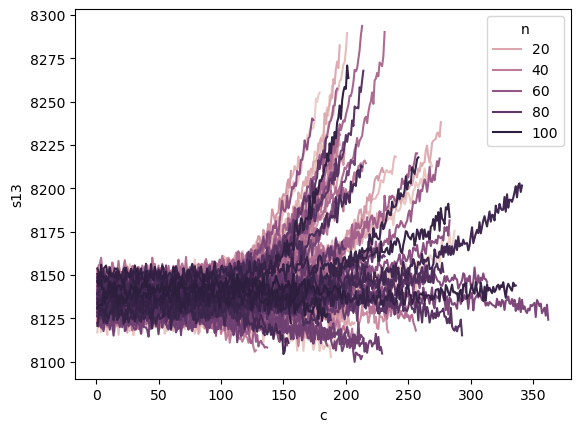

In [69]:
sns.lineplot(data=df, x='c', y='s13', hue='n')
# s8, s13번은 모든 기계가 각자도생형. 무언가 문제가있다???
# 사용 횟수에 따른 센서 값들의 변화 시각화
# 대부분은 몰려서 다니며 우하향이라는 추세를 보임
# 단 s8, s13의 센서값에 경우 모든 기게에 따라 제각기 흩어지는 경향을 보임.(label 후보)
# 또한 s8과 s13은 형태가 유사한 경향을 보임
# s7에서 몇몇의 센서값이 갑자기 튀어 오른것이 잇음

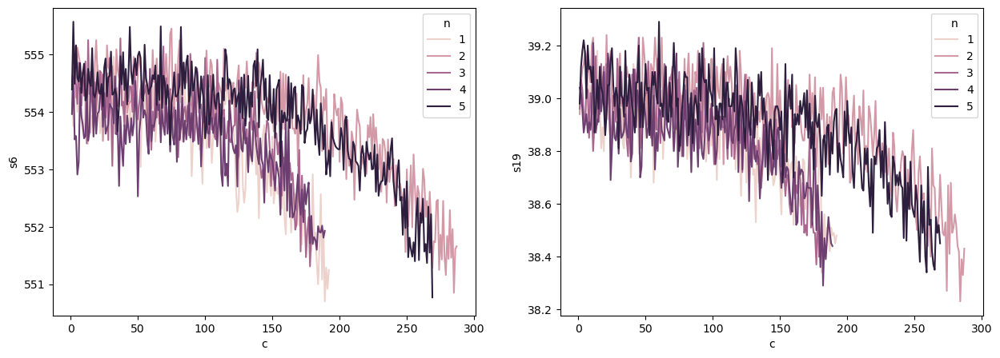

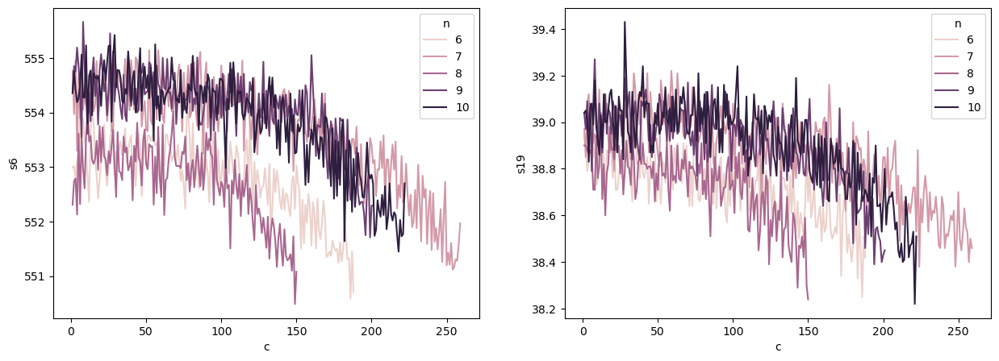

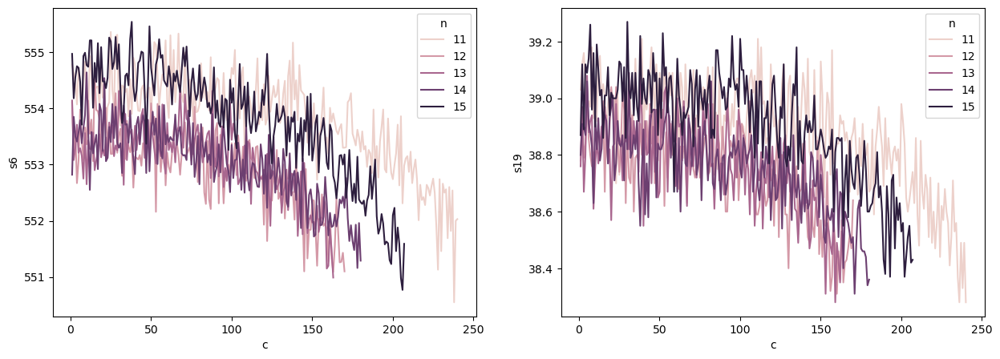

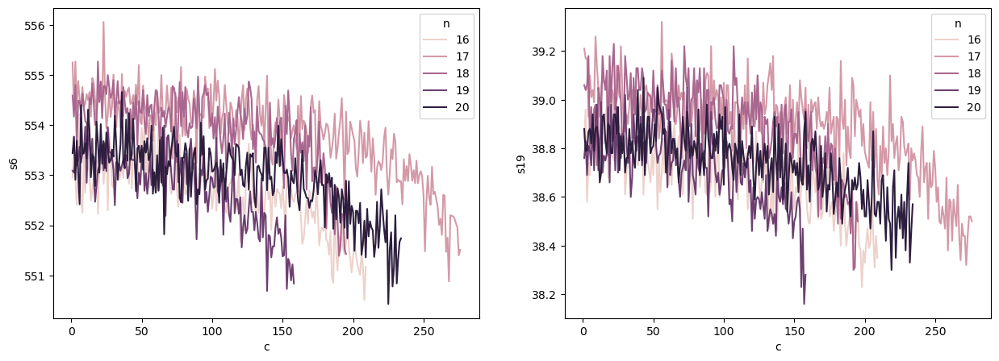

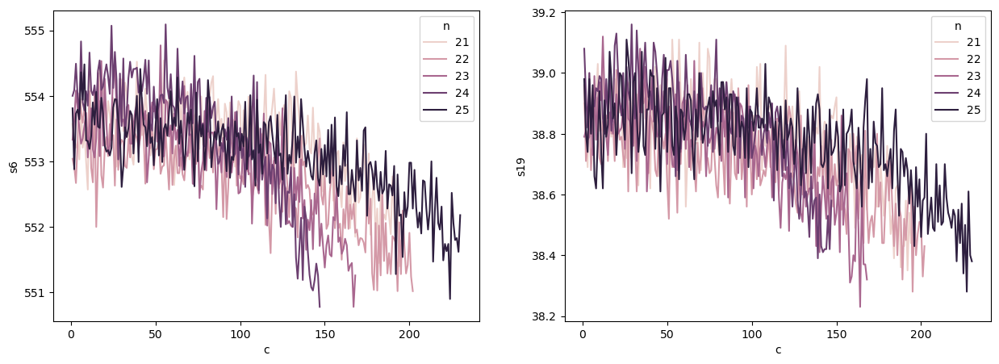

...

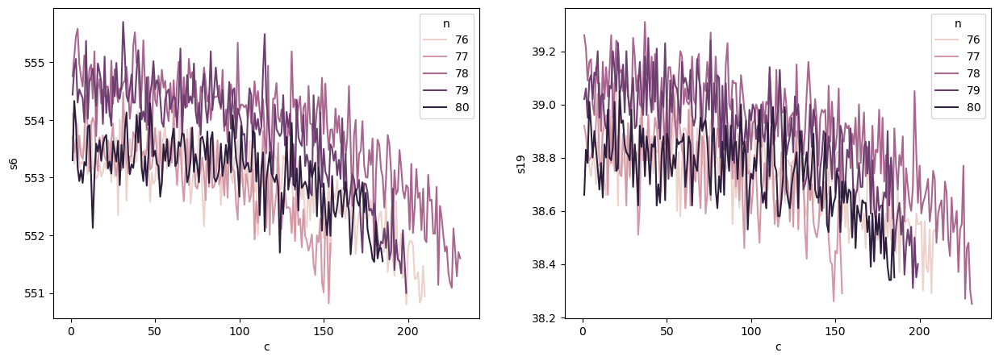

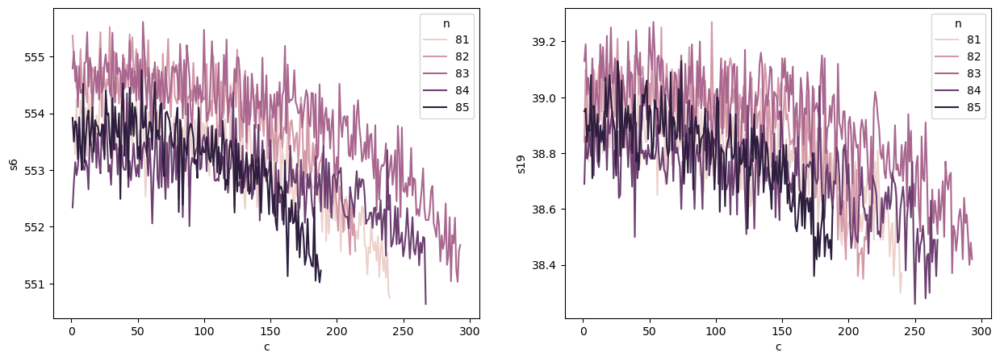

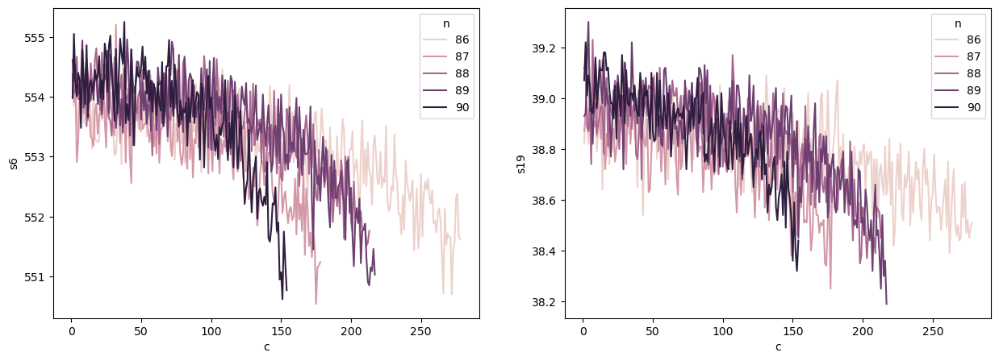

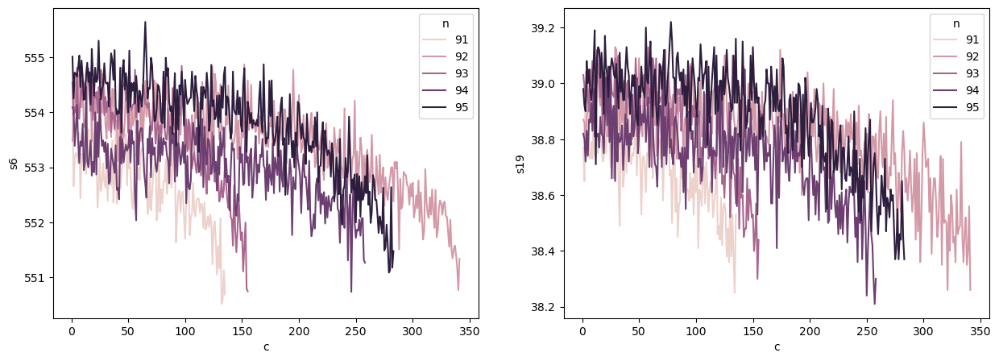

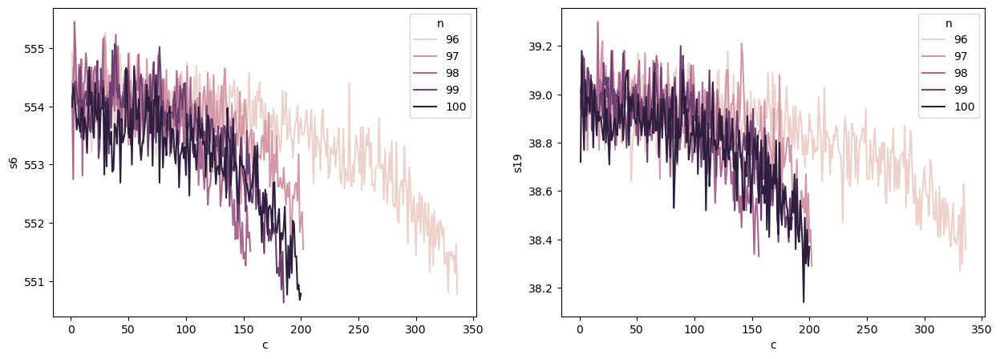

In [118]:
# 사용횟수가 증가함에 따라 s2가 증가함
# s2, 3, 4, 7, 10, 12, 14 증가한다는 것은 엔진의 수명이 줄고 있음
# s6, 11, 19, 20는 줄어듦
# 16은 조금 특이함(정수형)
for i in range(20):
    i = (i * 5) + 1
    fig , (ax1, ax2) = plt.subplots(ncols=2)
    fig.set_size_inches(15,5)
    plot_df = df.loc[df['n'].isin(range(i,i+5))]
    sns.lineplot(data=plot_df, x='c', y='s6', hue='n', ax=ax1)
    sns.lineplot(data=plot_df, x='c', y='s19', hue='n', ax=ax2)
    plt.show() 

1. n이 100개라는 것은 100개가 서로 다른 기계라는 말?
2. n에 따라 그냥 순차적으로 시차나 다른 요인에 관계없이 적어둠?
3. 같은 기종, 같은 공정이라 같은 요인 취급?

- 기계가 왜 바뀌는가?
- 가정: o의 변화 값에 따라 s들의 결과는 영향을 받는다.
- 기계마다 다른 사용되는 횟수가 다른 이유가 있다.
- 원인은 s8과 s13의 급격한 변화에 따른 중단으로 추측된다.
- o의 변화 -> s들의 변화 -> s8과 s13이 영향을 받는다로 추측이 된다.
    - o의 변화로 s들의 변화는 학습이 불가능하다. -> 입력은 s가 되어야 하면 o는 결과이자 입력으로 
- 참고 : s7에 갑자기 튀어오른 값들이 있다.

In [71]:
df.columns

Index(['n', 'c', 'o1', 'o2', 's2', 's3', 's4', 's6', 's7', 's8', 's10', 's11',
       's12', 's13', 's14', 's16', 's19', 's20', 'is_last', 'c_max', 'RUL'],
      dtype='object')

In [135]:
# 반대로 s들의 값이 o에 영향을 미친다면?
# o1 에 대한 평가는 0.99
# o2 에 대한 평가는 1이 나옴;;;

# 명백한 영향을 주고 있음 하지만 의미가 있냐????

features2 = ['s2', 's3', 's4', 's6', 's7', 's8', 's10', 's11', 's12', 's13', 's14', 's16', 's19', 's20']
# features2 = ['c', 's8', 's13']
label = 'RUL'

X_train, X_test, y_train, y_test = train_test_split(df[features2], df[label], test_size=0.2, random_state=42)

# train, test = df[0::2], df[1::2]
# x_train, y_train = train[features2], train[label]
# x_test, y_test = test[features2], test[label]



model = rfr()
model.fit(X_train, y_train)
model.score(X_test, y_test)

0.6241494765684446

In [136]:
im_df = pd.DataFrame()
im_df['importence'] = model.feature_importances_
im_df['features'] = features2
im_df.sort_values(by='importence',ascending=False)

,importence,features
6,0.385579,s10
2,0.141941,s4
5,0.126680,s8
7,0.055126,s11
3,0.040839,s6
9,0.039065,s13
13,0.034931,s20
10,0.034173,s14
1,0.030937,s3
0,0.029810,s2


<Axes: xlabel='RUL', ylabel='s11'>

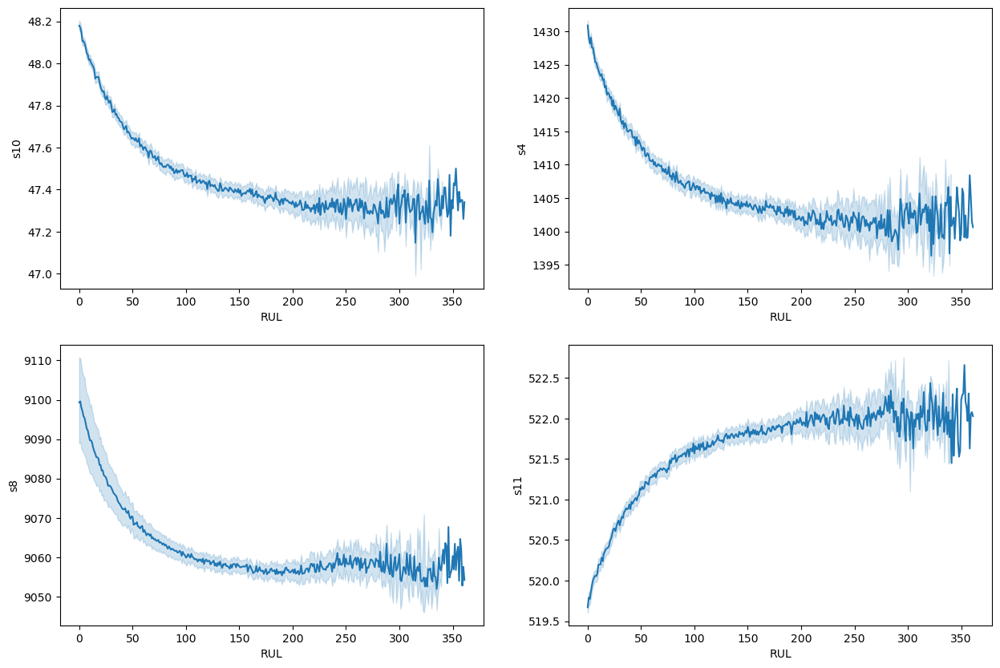

In [138]:
top = ['s10', 's4', 's8', 's11']
down = ['s19', 's12', 's7', 's16']
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(nrows=2, ncols=2)
fig.set_size_inches(15, 10)
sns.lineplot(data=df, x='RUL' , y='s10', ax=ax1)
sns.lineplot(data=df, x='RUL' , y='s4', ax=ax2)
sns.lineplot(data=df, x='RUL' , y='s8', ax=ax3)
sns.lineplot(data=df, x='RUL' , y='s11', ax=ax4)

In [174]:
df_scale=pd.DataFrame()

scaler = RobustScaler()

df_scale['n'] = df['n']
df_scale['c'] = df['c']
df_scale['o1'] =scaler.fit_transform(df[['o1']])
df_scale['o2'] = scaler.fit_transform(df[['o2']])
df_scale['s2'] = scaler.fit_transform(df[['s2']])
df_scale['s3'] = scaler.fit_transform(df[['s3']])
df_scale['s4'] = scaler.fit_transform(df[['s4']])
df_scale['s6'] = scaler.fit_transform(df[['s6']])
df_scale['s7'] = scaler.fit_transform(df[['s7']])
df_scale['s8'] = scaler.fit_transform(df[['s8']])
df_scale['s10'] = scaler.fit_transform(df[['s10']])
df_scale['s11'] = scaler.fit_transform(df[['s11']])
df_scale['s12'] = scaler.fit_transform(df[['s12']])
df_scale['s13'] = scaler.fit_transform(df[['s13']])
df_scale['s14'] = scaler.fit_transform(df[['s14']])
df_scale['s16'] = scaler.fit_transform(df[['s16']])
df_scale['s19'] = scaler.fit_transform(df[['s19']])
df_scale['s20'] = scaler.fit_transform(df[['s20']])
df_scale['c_max'] = df['c_max']
df_scale['RUL'] = df['RUL']



In [177]:
dfs = []
sensor = ['2','3','4','6','7','8','10','11','12','13','14','16','19','20']
for i in range(100):
    i = i + 1
    n_df = pd.DataFrame()
    for n in sensor :
        n_df['s'+n] = df_scale[df_scale['n']==i]['s'+n]
    n_df['RUL'] = df_scale[df_scale['n']==i]['RUL']
    n_df['c'] = df_scale[df_scale['n']==i]['c']
    dfs.append(n_df)

In [182]:
line_models_u = []
line_models_d = []
r_m_c = []
features_u = ['c', 's2', 's3', 's4', 's7' , 's10', 's12', 's14']
features_d = ['c', 's6', 's11', 's19', 's20']
features_c = ['c', 's8', 's13']
label = 'RUL'
i = 0

line_u = []
line_d = []
rf_c = []

for df in dfs:
    i += 1
    X_train, y_train = df[features_u], df[label]
    model = lr()
    model.fit(X_train, y_train)
    line_models_u.append((str(i)+'lr_u',model))

    X_train, y_train = df[features_d], df[label]
    model = lr()
    model.fit(X_train, y_train)
    line_models_d.append((str(i)+'lr_d',model))

    X_train, y_train = df[features_c], df[label]
    model = rfr()
    model.fit(X_train, y_train)
    r_m_c.append((str(i)+'rf_d',model))


In [185]:
features = ['c', 's2', 's3', 's4', 's6', 's7', 's8' , 's10', 's11', 's12','s13', 's14', 's16', 's19', 's20']
label = 'RUL'

X = df_scale[features]
y = df_scale[label]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

# 스태킹 회귀 모델 정의
stacking_model = sr(
    estimators=line_models_u + line_models_d + r_m_c,
    final_estimator=rfr()
)

# 모델 훈련
stacking_model.fit(X_train, y_train)


KeyboardInterrupt: 

In [ ]:
print(stacking_model.score(X_train, y_train), stacking_model.score(X_test, y_test))

In [129]:
X = df_scale[features]
y = df_scale[label]

# 데이터셋을 훈련 세트와 테스트 세트로 분할
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

# XGBoost 회귀 모델 초기화
xgb_reg = XGBRegressor(n_estimators=500, learning_rate=0.25, max_depth=5)

# 모델 훈련
xgb_reg.fit(X_train, y_train)

# 예측 수행
y_preds = xgb_reg.predict(X_test)

# 모델 평가
mse = mean_squared_error(y_test, y_preds)
r2_score(y_test, y_preds)

0.47200149939861624

In [141]:
# 사용횟수가 증가함에 따라 s2가 증가함
# s2, 3, 4, 7, 10, 12, 14 증가한다는 것은 엔진의 수명이 줄고 있음
# s6, 11, 19, 20는 줄어듦
# 16은 조금 특이함(정수형)

# features = ['c', 's2', 's3', 's4', 's6', 's7' , 's10', 's11', 's12', 's14', 's16', 's19', 's20']
features = ['s2', 's3', 's4', 's7' , 's10', 's12', 's14']
# features = ['c','s10', 's4', 's8', 's11']
label = 'RUL'

X = df_scale[features]
y = df_scale[label]

# 데이터셋을 훈련 세트와 테스트 세트로 분할
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.10)

model_u = lr()
model_u.fit(X_train, y_train)
model_u.score(X_test, y_test)

0.6437928677842053

<Axes: >

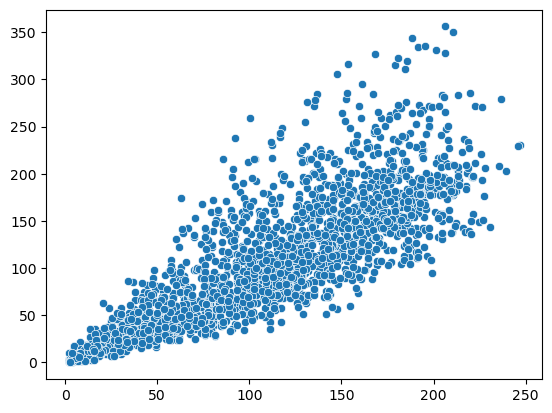

In [122]:
sns.scatterplot(x=linear_model_u.predict(X_test), y=y_test.values)

In [113]:
# 사용횟수가 증가함에 따라 s2가 증가함
# s2, 3, 4, 7, 10, 12, 14 증가한다는 것은 엔진의 수명이 줄고 있음
# s6, 11, 19, 20는 줄어듦
# 16은 조금 특이함(정수형)

features = ['n', 'c', 's6', 's11', 's19', 's20']
label = 's8'

X = df_scale[features]
y = df_scale[label]

# 데이터셋을 훈련 세트와 테스트 세트로 분할
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20)

linear_model_d = rfr()
linear_model_d.fit(X_train, y_train)
linear_model_d.score(X_test, y_test)

0.90491679749256

<Axes: >

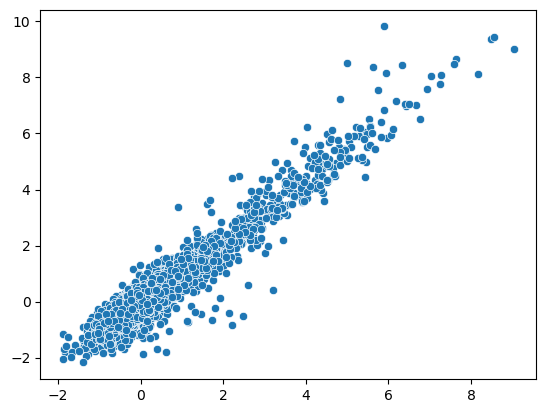

In [114]:
sns.scatterplot(x=linear_model_d.predict(X_test), y=y_test.values)

In [168]:
# features = ['s2', 's3', 's4', 's6', 's7', 's8' , 's10', 's11', 's12','s13', 's14', 's16', 's19', 's20']
features = ['c', 's10', 's4', 's8', 's11']
label = 'RUL_log'

X = df[features]
y = df[label]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20)

m1, m2, m3, m4 = rfr(), xg(), lg(), cb(silent=True) 
m1.fit(X_train, y_train)
m2.fit(X_train, y_train)
m3.fit(X_train, y_train)
m4.fit(X_train, y_train)

print(m1.score(X_train, y_train), m1.score(X_test, y_test))
print(m2.score(X_train, y_train), m2.score(X_test, y_test))
print(m3.score(X_train, y_train), m3.score(X_test, y_test))
print(m4.score(X_train, y_train), m4.score(X_test, y_test))

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000269 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1170
[LightGBM] [Info] Number of data points in the train set: 16504, number of used features: 5
[LightGBM] [Info] Start training from score 107.514057
0.9586288999255391 0.6959133769084861
0.853964369766072 0.6842901638419281
0.7739846761087325 0.7115740473874225
0.7918804977774561 0.7092208215626317


In [187]:
import random as r
import time as t
import numpy as np
import threading as th

In [ ]:
sec = 60
end_time = t.time() + sec

all_recall_ls = []

end_trigger = True
while end_trigger:
    md = r.randint(20,50)
    mf = r.randint(1,999) / 1000
    model = lg(max_depth=md, max_features=mf, num_leaves)
    all_score.append({'recall':scorer(model), 'md':md, 'mf':mf})
    
    if t.time() > end_time:
        end_trigger = False


rhyper_df = pd.DataFrame(all_score)
rhyper_df.sort_values(by='recall', ascending=False).loc[rhyper_df['recall'] > 0.77]

#### RUL이 0에 가까워 질수록 의미가 커진다는 성질을 어떻게 반영할 것인가
- 로그 변환 활용
- 0에 가까울 수록 기울기가 커짐

In [188]:
df['RUL_log'] = df['RUL'].apply(lambda x : np.log(x))

C:\Users\405-11\AppData\Local\Temp\ipykernel_8576\2638830573.py:1: RuntimeWarning: divide by zero encountered in log
  df['RUL_log'] = df['RUL'].apply(lambda x : np.log(x))


### Hyperparameter tuning
- Grid-Search, Random-Search, Optimizer
- 함수 -> 정의역(Hyperpamater), 치역

In [ ]:
pbounds = {'ra': (2, 4), 'rl': (-3, 3), 'lr':(), 'md':(5,20)}
def param_find(ra, rl, lr, md):
    model = xg(n_jobs=-1, reg_alpha=ra, )


optimizer = BayesianOptimization(
    f=black_box_function,
    pbounds=pbounds,
    verbose=2, # verbose = 1 prints only when a maximum is observed, verbose = 0 is silent
    random_state=1,
)
def alpha_search(alpha):
    sample_model = xg(n_jobs=-1, reg_alpha=alpha)
    sample_model.fit()